In [1]:
#Heavy Decoder 
#BottleNeck: 12

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18],[22, 20]]
decoder_dense_layers_trial = [[6, 8, 10, 12], [8, 10, 12, 14], [10, 12, 14, 16], [12, 14, 16, 18], [14, 16, 18, 20], 
                              [16, 18, 20, 22], [18, 20, 22, 24]]
bottle_neck_trial = [12]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 12 [6, 8, 10, 12]
[10, 8] 12 [8, 10, 12, 14]
[10, 8] 12 [10, 12, 14, 16]
[10, 8] 12 [12, 14, 16, 18]
[10, 8] 12 [14, 16, 18, 20]
[10, 8] 12 [16, 18, 20, 22]
[10, 8] 12 [18, 20, 22, 24]
[12, 10] 12 [6, 8, 10, 12]
[12, 10] 12 [8, 10, 12, 14]
[12, 10] 12 [10, 12, 14, 16]
[12, 10] 12 [12, 14, 16, 18]
[12, 10] 12 [14, 16, 18, 20]
[12, 10] 12 [16, 18, 20, 22]
[12, 10] 12 [18, 20, 22, 24]
[14, 12] 12 [6, 8, 10, 12]
[14, 12] 12 [8, 10, 12, 14]
[14, 12] 12 [10, 12, 14, 16]
[14, 12] 12 [12, 14, 16, 18]
[14, 12] 12 [14, 16, 18, 20]
[14, 12] 12 [16, 18, 20, 22]
[14, 12] 12 [18, 20, 22, 24]
[16, 14] 12 [6, 8, 10, 12]
[16, 14] 12 [8, 10, 12, 14]
[16, 14] 12 [10, 12, 14, 16]
[16, 14] 12 [12, 14, 16, 18]
[16, 14] 12 [14, 16, 18, 20]
[16, 14] 12 [16, 18, 20, 22]
[16, 14] 12 [18, 20, 22, 24]
[18, 16] 12 [6, 8, 10, 12]
[18, 16] 12 [8, 10, 12, 14]
[18, 16] 12 [10, 12, 14, 16]
[18, 16] 12 [12, 14, 16, 18]
[18, 16] 12 [14, 16, 18, 20]
[18, 16] 12 [16, 18, 20, 22]
[18, 16]

[10, 8] 12 [6, 8, 10, 12]
[10, 8] 12 [6, 8, 10, 12]

L24_E10_8_B12_D6_8_10_12

Training model: L24_E10_8_B12_D6_8_10_12
Training Complete:
Last epoch loss: 0.020852260291576385
Last epoch validation loss: 0.029933249577879906
Reports Saved
[10, 8] 12 [8, 10, 12, 14]
[10, 8] 12 [8, 10, 12, 14]

L24_E10_8_B12_D8_10_12_14

Training model: L24_E10_8_B12_D8_10_12_14
Training Complete:
Last epoch loss: 0.02058027684688568
Last epoch validation loss: 0.030028140172362328
Reports Saved
[10, 8] 12 [10, 12, 14, 16]
[10, 8] 12 [10, 12, 14, 16]

L24_E10_8_B12_D10_12_14_16

Training model: L24_E10_8_B12_D10_12_14_16
Training Complete:
Last epoch loss: 0.01220022514462471
Last epoch validation loss: 0.020292405039072037
Reports Saved
[10, 8] 12 [12, 14, 16, 18]
[10, 8] 12 [12, 14, 16, 18]

L24_E10_8_B12_D12_14_16_18

Training model: L24_E10_8_B12_D12_14_16_18
Training Complete:
Last epoch loss: 0.01082265842705965
Last epoch validation loss: 0.01848939061164856
Reports Saved
[10, 8] 12 [14, 16, 18, 

Reports Saved
[12, 10] 12 [16, 18, 20, 22]
[12, 10] 12 [16, 18, 20, 22]

L24_E12_10_B12_D16_18_20_22

Training model: L24_E12_10_B12_D16_18_20_22
Training Complete:
Last epoch loss: 0.007908825762569904
Last epoch validation loss: 0.014001522213220596
Reports Saved
[12, 10] 12 [18, 20, 22, 24]
[12, 10] 12 [18, 20, 22, 24]

L24_E12_10_B12_D18_20_22_24

Training model: L24_E12_10_B12_D18_20_22_24
Training Complete:
Last epoch loss: 0.009199760854244232
Last epoch validation loss: 0.01670053042471409
Reports Saved
[14, 12] 12 [6, 8, 10, 12]
[14, 12] 12 [6, 8, 10, 12]

L24_E14_12_B12_D6_8_10_12

Training model: L24_E14_12_B12_D6_8_10_12
Training Complete:
Last epoch loss: 0.01553212758153677
Last epoch validation loss: 0.025982391089200974
Reports Saved
[14, 12] 12 [8, 10, 12, 14]
[14, 12] 12 [8, 10, 12, 14]

L24_E14_12_B12_D8_10_12_14

Training model: L24_E14_12_B12_D8_10_12_14
Training Complete:
Last epoch loss: 0.012011803686618805
Last epoch validation loss: 0.01985655166208744
Reports

Reports Saved
[16, 14] 12 [6, 8, 10, 12]
[16, 14] 12 [6, 8, 10, 12]

L24_E16_14_B12_D6_8_10_12

Training model: L24_E16_14_B12_D6_8_10_12
Training Complete:
Last epoch loss: 0.01701739802956581
Last epoch validation loss: 0.029135949909687042
Reports Saved
[16, 14] 12 [8, 10, 12, 14]
[16, 14] 12 [8, 10, 12, 14]

L24_E16_14_B12_D8_10_12_14

Training model: L24_E16_14_B12_D8_10_12_14
Training Complete:
Last epoch loss: 0.011995217762887478
Last epoch validation loss: 0.01984134502708912
Reports Saved
[16, 14] 12 [10, 12, 14, 16]
[16, 14] 12 [10, 12, 14, 16]

L24_E16_14_B12_D10_12_14_16

Training model: L24_E16_14_B12_D10_12_14_16
Training Complete:
Last epoch loss: 0.00842205435037613
Last epoch validation loss: 0.015579781495034695
Reports Saved
[16, 14] 12 [12, 14, 16, 18]
[16, 14] 12 [12, 14, 16, 18]

L24_E16_14_B12_D12_14_16_18

Training model: L24_E16_14_B12_D12_14_16_18
Training Complete:
Last epoch loss: 0.011621462181210518
Last epoch validation loss: 0.019679062068462372
Reports

Reports Saved
[18, 16] 12 [10, 12, 14, 16]
[18, 16] 12 [10, 12, 14, 16]

L24_E18_16_B12_D10_12_14_16

Training model: L24_E18_16_B12_D10_12_14_16
Training Complete:
Last epoch loss: 0.009717763401567936
Last epoch validation loss: 0.018853044137358665
Reports Saved
[18, 16] 12 [12, 14, 16, 18]
[18, 16] 12 [12, 14, 16, 18]

L24_E18_16_B12_D12_14_16_18

Training model: L24_E18_16_B12_D12_14_16_18
Training Complete:
Last epoch loss: 0.013606528751552105
Last epoch validation loss: 0.019454963505268097
Reports Saved
[18, 16] 12 [14, 16, 18, 20]
[18, 16] 12 [14, 16, 18, 20]

L24_E18_16_B12_D14_16_18_20

Training model: L24_E18_16_B12_D14_16_18_20
Training Complete:
Last epoch loss: 0.014664818532764912
Last epoch validation loss: 0.023023385554552078
Reports Saved
[18, 16] 12 [16, 18, 20, 22]
[18, 16] 12 [16, 18, 20, 22]

L24_E18_16_B12_D16_18_20_22

Training model: L24_E18_16_B12_D16_18_20_22
Training Complete:
Last epoch loss: 0.007571518421173096
Last epoch validation loss: 0.01412317715

Reports Saved
[20, 18] 12 [14, 16, 18, 20]
[20, 18] 12 [14, 16, 18, 20]

L24_E20_18_B12_D14_16_18_20

Training model: L24_E20_18_B12_D14_16_18_20
Training Complete:
Last epoch loss: 0.011016244068741798
Last epoch validation loss: 0.018058359622955322
Reports Saved
[20, 18] 12 [16, 18, 20, 22]
[20, 18] 12 [16, 18, 20, 22]

L24_E20_18_B12_D16_18_20_22

Training model: L24_E20_18_B12_D16_18_20_22
Training Complete:
Last epoch loss: 0.007649988867342472
Last epoch validation loss: 0.01323265116661787
Reports Saved
[20, 18] 12 [18, 20, 22, 24]
[20, 18] 12 [18, 20, 22, 24]

L24_E20_18_B12_D18_20_22_24

Training model: L24_E20_18_B12_D18_20_22_24
Training Complete:
Last epoch loss: 0.010399477556347847
Last epoch validation loss: 0.017442474141716957
Reports Saved
[22, 20] 12 [6, 8, 10, 12]
[22, 20] 12 [6, 8, 10, 12]

L24_E22_20_B12_D6_8_10_12

Training model: L24_E22_20_B12_D6_8_10_12
Training Complete:
Last epoch loss: 0.017334213480353355
Last epoch validation loss: 0.027128485962748528
R

Reports Saved
[22, 20] 12 [18, 20, 22, 24]
[22, 20] 12 [18, 20, 22, 24]

L24_E22_20_B12_D18_20_22_24

Training model: L24_E22_20_B12_D18_20_22_24
Training Complete:
Last epoch loss: 0.009587357752025127
Last epoch validation loss: 0.018937883898615837
Reports Saved
Total time: 48.758056191603345 minutes


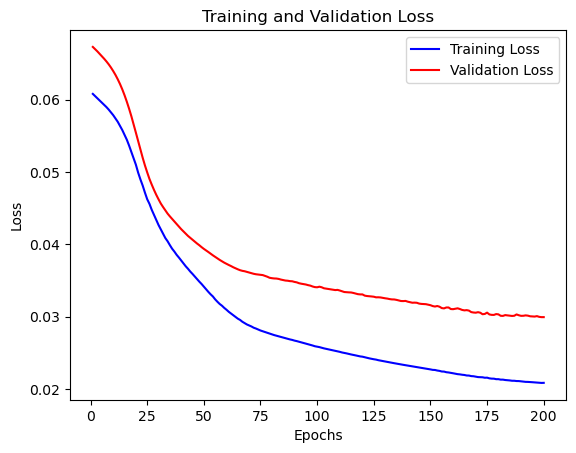

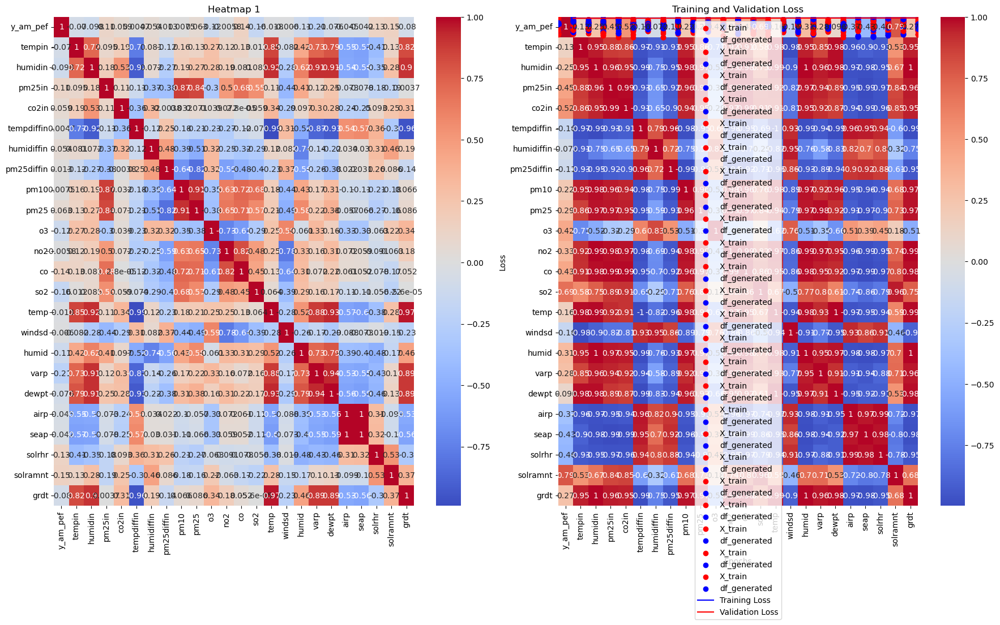

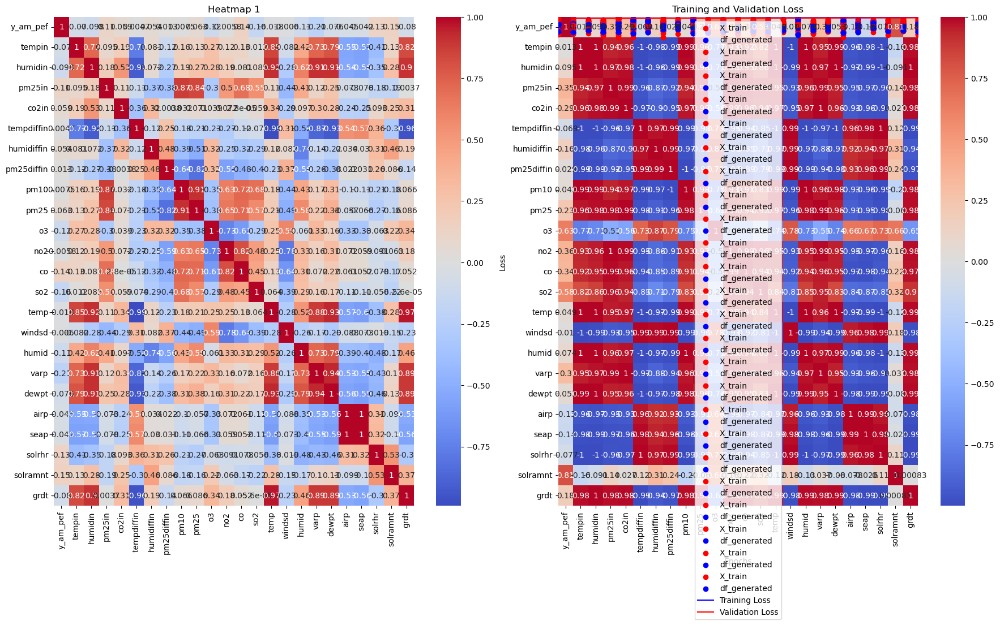

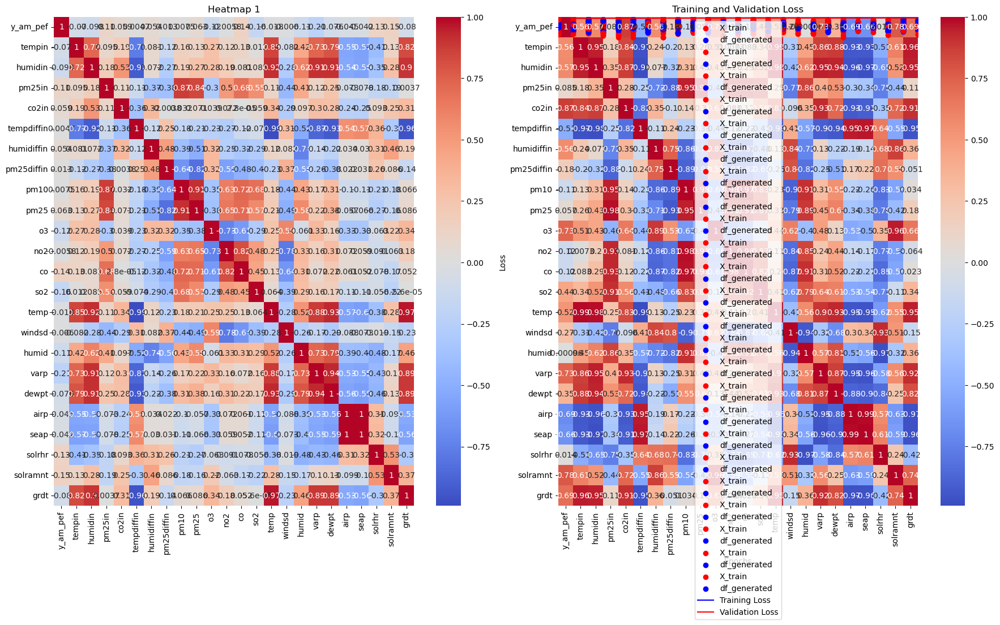

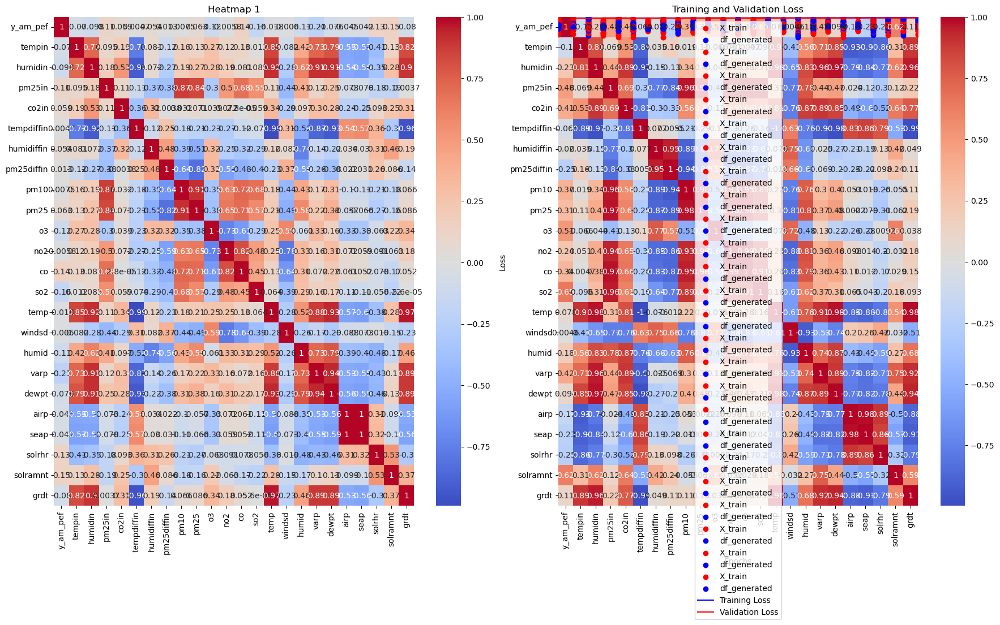

...

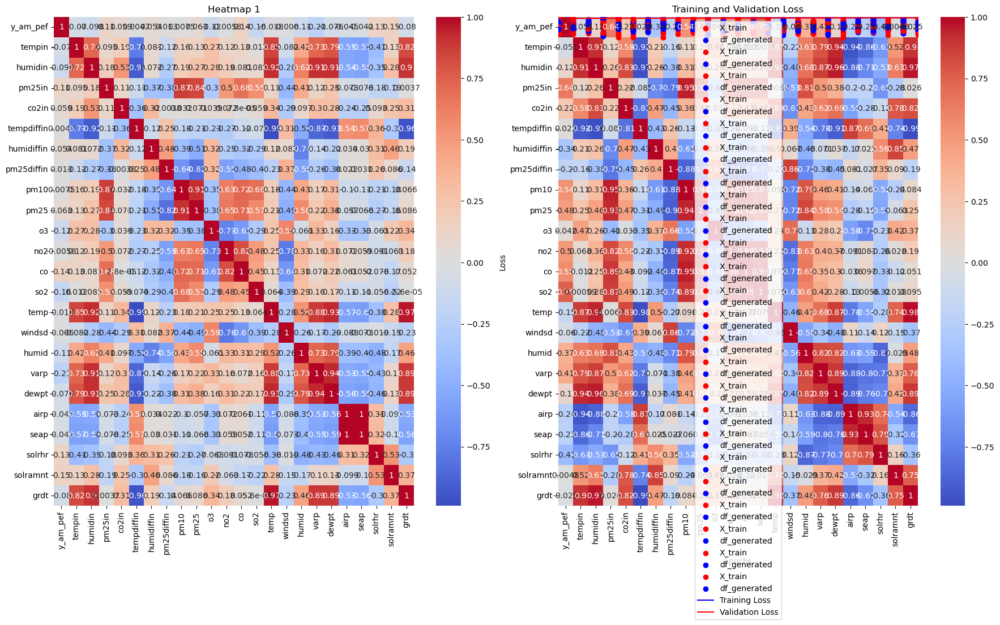

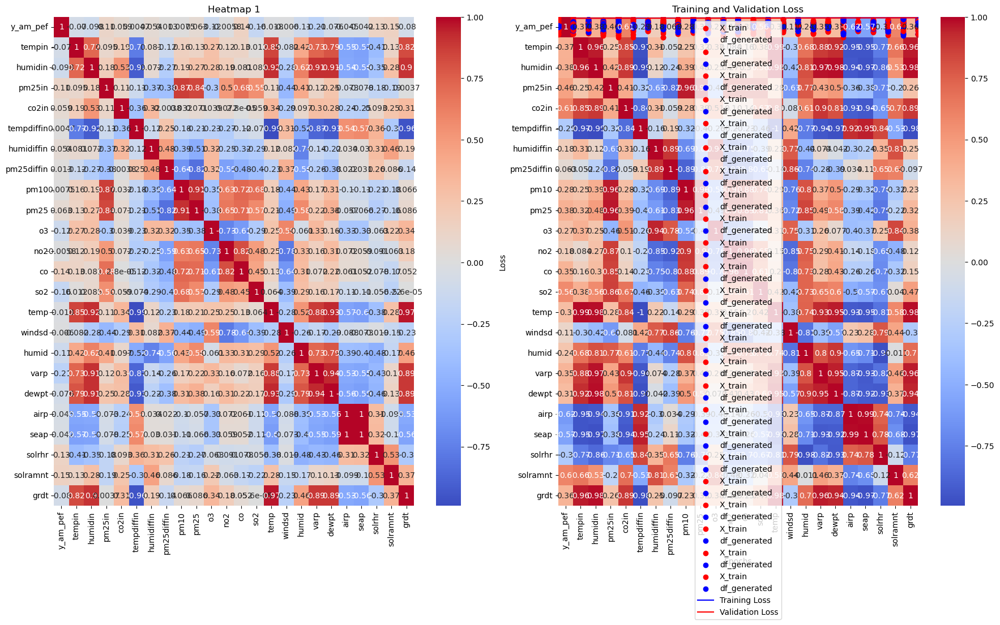

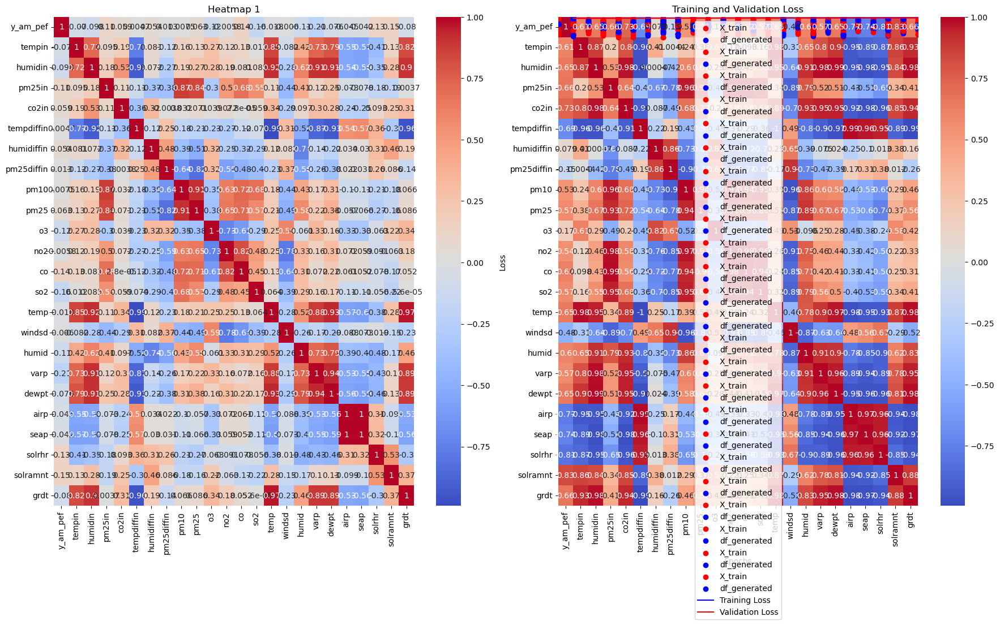

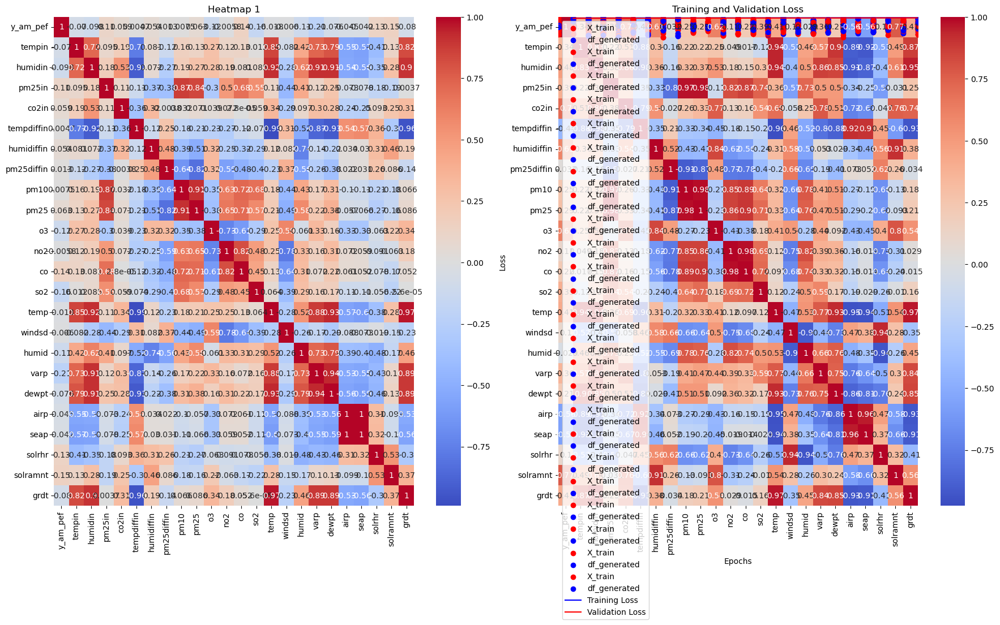

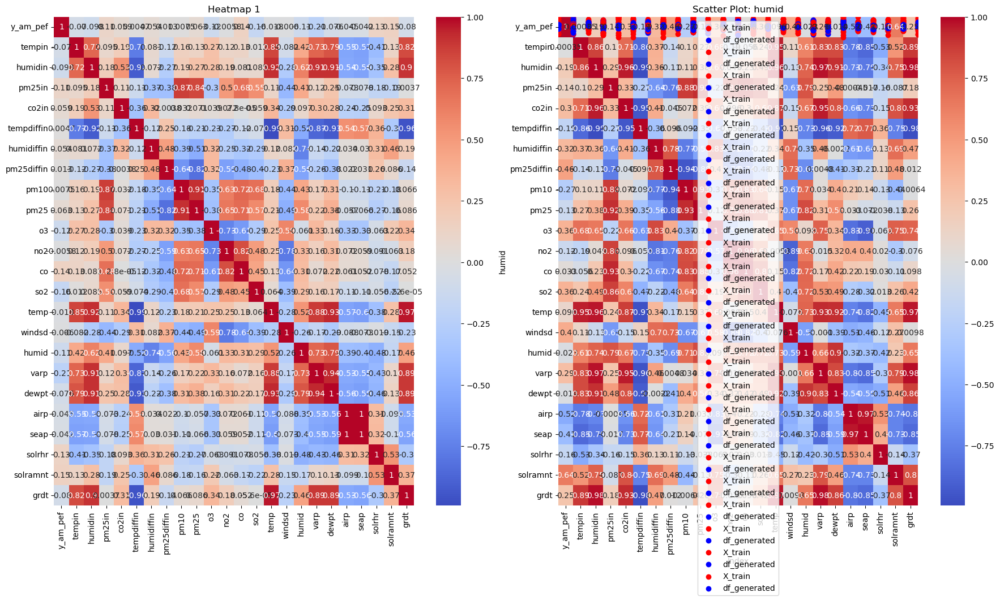

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [13]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E10_8_B12_D6_8_10_12', 0.020852260291576385, 0.029933249577879906]
['L24_E10_8_B12_D8_10_12_14', 0.02058027684688568, 0.030028140172362328]
['L24_E22_20_B12_D6_8_10_12', 0.017334213480353355, 0.027128485962748528]
['L24_E16_14_B12_D6_8_10_12', 0.01701739802956581, 0.029135949909687042]
['L24_E20_18_B12_D10_12_14_16', 0.01565464399755001, 0.027118146419525146]
['L24_E14_12_B12_D6_8_10_12', 0.01553212758153677, 0.025982391089200974]
['L24_E18_16_B12_D8_10_12_14', 0.014781562611460686, 0.02319755032658577]
['L24_E18_16_B12_D14_16_18_20', 0.014664818532764912, 0.023023385554552078]
['L24_E12_10_B12_D6_8_10_12', 0.014082247391343117, 0.02091844752430916]
['L24_E12_10_B12_D14_16_18_20', 0.0140636395663023, 0.02191740833222866]


In [14]:
for item in run_summary:
    print(item)

['L24_E10_8_B12_D6_8_10_12', 0.020852260291576385, 0.029933249577879906]
['L24_E10_8_B12_D8_10_12_14', 0.02058027684688568, 0.030028140172362328]
['L24_E22_20_B12_D6_8_10_12', 0.017334213480353355, 0.027128485962748528]
['L24_E16_14_B12_D6_8_10_12', 0.01701739802956581, 0.029135949909687042]
['L24_E20_18_B12_D10_12_14_16', 0.01565464399755001, 0.027118146419525146]
['L24_E14_12_B12_D6_8_10_12', 0.01553212758153677, 0.025982391089200974]
['L24_E18_16_B12_D8_10_12_14', 0.014781562611460686, 0.02319755032658577]
['L24_E18_16_B12_D14_16_18_20', 0.014664818532764912, 0.023023385554552078]
['L24_E12_10_B12_D6_8_10_12', 0.014082247391343117, 0.02091844752430916]
['L24_E12_10_B12_D14_16_18_20', 0.0140636395663023, 0.02191740833222866]
['L24_E12_10_B12_D10_12_14_16', 0.013898920267820358, 0.02346613071858883]
['L24_E18_16_B12_D12_14_16_18', 0.013606528751552105, 0.019454963505268097]
['L24_E22_20_B12_D8_10_12_14', 0.013127338141202927, 0.02065436728298664]
['L24_E12_10_B12_D8_10_12_14', 0.01307